# Data Science for Cycling #2 - How To Visualize GPX Strava Routes With Python and Folium
- Notebook 2/6
- Make sure to have folium installed:

```
pip install folium
````

Let's import the libraries and tweak Matplotlib's default stylings:

In [1]:
%pip install folium

Defaulting to user installation because normal site-packages is not writeable
Looking in indexes: https://pypi.org/simple, https://www.piwheels.org/simple
Note: you may need to restart the kernel to use updated packages.


In [2]:
import folium
import pandas as pd

import matplotlib.pyplot as plt
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.right'] = False
from IPython.display import display

- Let's read in the dataset
- We've saved it to a CSV file in the previous notebook:

In [3]:
route_df = pd.read_csv('../200km_route_df.csv', parse_dates=['time'])
route_df.head()

,latitude,longitude,elevation,time
0,48.089763,11.466253,522.4,2020-07-12 06:26:18+00:00
1,48.089763,11.466253,522.6,2020-07-12 06:26:19+00:00
2,48.089763,11.466253,522.6,2020-07-12 06:26:20+00:00
3,48.089763,11.466253,522.6,2020-07-12 06:26:21+00:00
4,48.089763,11.466253,522.6,2020-07-12 06:26:22+00:00


- To start, let's repeat our basic Matplotlib visualization
- It's not the best one, as it doesn't show a map below the markers:

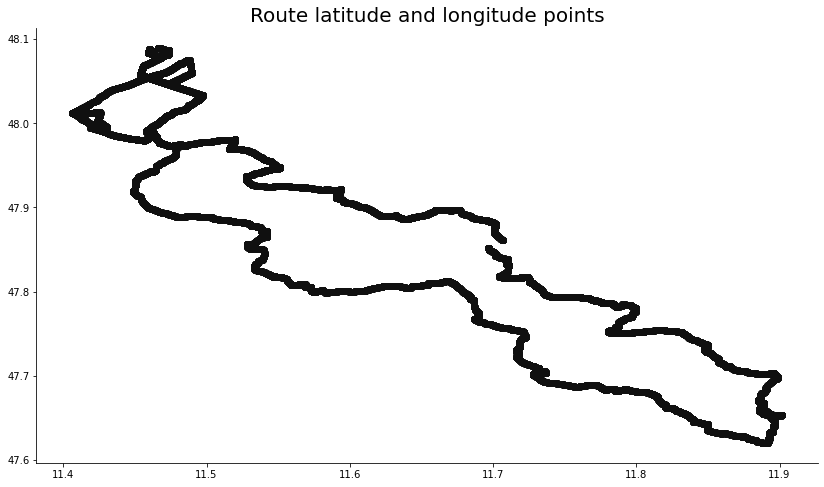

In [4]:
plt.figure(figsize=(14, 8))
plt.scatter(route_df['longitude'], route_df['latitude'], color='#101010')
plt.title('Route latitude and longitude points', size=20);

<br>

## Visualize Strava Routes with Folium
- You'll need latitude and longitude for the west part of Zagreb, Croatia
- Everything else is self-explanatory:

In [5]:
map_settings = {'location': route_df.iloc[9,:2].values,
    'zoom_start': 9,
    'tiles': 'OpenStreetMap',
    'width': 1024,
    'height': 600}

In [6]:
route_map = folium.Map(**map_settings)
display(route_map)

- That doesn't plot the route!
- To do so, iterate over the dataset and add a circle marker:

In [7]:
route_map = folium.Map(**map_settings)

for _, row in route_df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
    ).add_to(route_map)

display(route_map)

- Better, but markers aren't the best option for routes
- You can create a polygon line instead
- Doing so requires you to have latitude and longitude stored as a list of tuples:

In [8]:
route_map = folium.Map(**map_settings)

coordinates = [tuple(x) for x in route_df[['latitude', 'longitude']].to_numpy()]
folium.PolyLine(coordinates, weight=6).add_to(route_map)

display(route_map)

- Much better, but what is you want a more simpler map?
- You can use `CartoDBPositron` if you want a minimalistic, light-themed map:

In [9]:
route_map = folium.Map(
    location=route_df.iloc[9,:2].values,
    zoom_start=9,
    tiles='CartoDBPositron',
    width=1024,
    height=600
)

coordinates = [tuple(x) for x in route_df[['latitude', 'longitude']].to_numpy()]
folium.PolyLine(coordinates, weight=6).add_to(route_map)

display(route_map)

- If you want the same minimalistic map but in dark theme, use `CartoDBDark_Matter`:

In [10]:
route_map = folium.Map(
    location=route_df.iloc[9,:2].values,
    zoom_start=9,
    tiles='CartoDBDark_Matter',
    width=1024,
    height=600
)

coordinates = [tuple(x) for x in route_df[['latitude', 'longitude']].to_numpy()]
folium.PolyLine(coordinates, weight=6).add_to(route_map)

display(route_map)

- You can inspect the available tile options in the documentation
- Check under `tiles`:

In [11]:
folium.Map?